In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import scienceplots
from matplotlib.ticker import FuncFormatter
from mpl_toolkits.axes_grid1.inset_locator import inset_axes
import matplotlib.ticker as ticker

import sys
import os

current_dir = os.getcwd()
module_path = os.path.abspath(os.path.join(current_dir, '..', 'libs'))
if module_path not in sys.path:
    sys.path.append(module_path)
from cross_correlation_matcher_specific import *

In [2]:
def year_week_to_date(year, week):
    # On prend le lundi de la semaine donnée
    return datetime.datetime.strptime(f"{year}-W{week}-1", "%Y-W%W-%w").strftime("%Y-%m-%d")


In [3]:
df_pop = pd.read_csv('../outputs/files/ww_estimator/df_SEC_final.csv', sep=";")
df_pop.dateStart = pd.to_datetime(df_pop.dateStart)
df_pop.set_index('dateStart', inplace=True)

In [4]:
ww_data_nvgi = pd.read_csv('../outputs/files/viral_data_manuscript/Norovirus-GI.csv', sep=";")
ww_data_nvgi.dateStart = pd.to_datetime(ww_data_nvgi.dateStart)
ww_data_nvgi.set_index('dateStart', inplace=True)
ww_data_nvgi = ww_data_nvgi.join(df_pop['Nt_hat_4'])

for col in ['muX', 'ICL', 'ICU', 'obs']:
    ww_data_nvgi[col] = 10**ww_data_nvgi[col]
    ww_data_nvgi[col] /= ww_data_nvgi['Nt_hat_4']
    ww_data_nvgi[col] *= 1000 #1000EH at denom
    ww_data_nvgi[col] = np.log10(ww_data_nvgi[col])
    
ww_data_nvgi.reset_index(inplace=True)

In [5]:
ww_data_nvgii = pd.read_csv('../outputs/files/viral_data_manuscript/Norovirus-GII.csv', sep=";")
ww_data_nvgii.dateStart = pd.to_datetime(ww_data_nvgii.dateStart)
ww_data_nvgii.set_index('dateStart', inplace=True)
ww_data_nvgii = ww_data_nvgii.join(df_pop['Nt_hat_4'])

for col in ['muX', 'ICL', 'ICU', 'obs']:
    ww_data_nvgii[col] = 10**ww_data_nvgii[col]
    ww_data_nvgii[col] /= ww_data_nvgii['Nt_hat_4']
    ww_data_nvgii[col] *= 1000 #1000EH au denom
    ww_data_nvgii[col] = np.log10(ww_data_nvgii[col])

ww_data_nvgii.reset_index(inplace=True)

In [6]:
cases_data = pd.read_csv('../data/incidence_data/Incidence_NVG.csv', sep=";")
cases_data.dateStart = pd.to_datetime(cases_data.dateStart)

In [7]:
ww_data_aichi = pd.read_csv('../outputs/files/viral_data_manuscript/Aichi virus A.csv', sep=";")
ww_data_aichi.dateStart = pd.to_datetime(ww_data_aichi.dateStart)
ww_data_aichi.set_index('dateStart', inplace=True)
ww_data_aichi = ww_data_aichi.join(df_pop['Nt_hat_4'])

for col in ['muX', 'ICL', 'ICU', 'obs']:
    ww_data_aichi[col] = 10**ww_data_aichi[col]
    ww_data_aichi[col] /= ww_data_aichi['Nt_hat_4']
    ww_data_aichi[col] *= 1000 #1000EH au denom
    ww_data_aichi[col] = np.log10(ww_data_aichi[col])

ww_data_aichi.reset_index(inplace=True)

In [8]:
ww_data_astro = pd.read_csv('../outputs/files/viral_data_manuscript/Astrovirus (8 serotypes).csv', sep=";")
ww_data_astro.dateStart = pd.to_datetime(ww_data_astro.dateStart)
ww_data_astro.set_index('dateStart', inplace=True)
ww_data_astro = ww_data_astro.join(df_pop['Nt_hat_4'])

for col in ['muX', 'ICL', 'ICU', 'obs']:
    ww_data_astro[col] = 10**ww_data_astro[col]
    ww_data_astro[col] /= ww_data_astro['Nt_hat_4']
    ww_data_astro[col] *= 1000 #1000EH au denom
    ww_data_astro[col] = np.log10(ww_data_astro[col])

ww_data_astro.reset_index(inplace=True)

In [9]:
ww_data_sapo = pd.read_csv('../outputs/files/viral_data_manuscript/SAPOVIRUS.csv', sep=";")
ww_data_sapo.dateStart = pd.to_datetime(ww_data_sapo.dateStart)
ww_data_sapo.set_index('dateStart', inplace=True)
ww_data_sapo = ww_data_sapo.join(df_pop['Nt_hat_4'])

for col in ['muX', 'ICL', 'ICU', 'obs']:
    ww_data_sapo[col] = 10**ww_data_sapo[col]
    ww_data_sapo[col] /= ww_data_sapo['Nt_hat_4']
    ww_data_sapo[col] *= 1000 #1000EH au denom
    ww_data_sapo[col] = np.log10(ww_data_sapo[col])

ww_data_sapo.reset_index(inplace=True)

In [10]:
ww_data_rota = pd.read_csv('../outputs/files/viral_data_manuscript/Rotavirus.csv', sep=";")
ww_data_rota.dateStart = pd.to_datetime(ww_data_rota.dateStart)
ww_data_rota.set_index('dateStart', inplace=True)
ww_data_rota = ww_data_rota.join(df_pop['Nt_hat_4'])

for col in ['muX', 'ICL', 'ICU', 'obs']:
    ww_data_rota[col] = 10**ww_data_rota[col]
    ww_data_rota[col] /= ww_data_rota['Nt_hat_4']
    ww_data_rota[col] *= 1000 #1000EH au denom
    ww_data_rota[col] = np.log10(ww_data_rota[col])

ww_data_rota.reset_index(inplace=True)

In [11]:
ww_data_sars = pd.read_csv('../outputs/files/viral_data_manuscript/SARS-CoV-2.csv', sep=";")
ww_data_sars.dateStart = pd.to_datetime(ww_data_sars.dateStart)
ww_data_sars.set_index('dateStart', inplace=True)
ww_data_sars = ww_data_sars.join(df_pop['Nt_hat_4'])

for col in ['muX', 'ICL', 'ICU', 'obs']:
    ww_data_sars[col] = 10**ww_data_sars[col]
    ww_data_sars[col] /= ww_data_sars['Nt_hat_4']
    ww_data_sars[col] *= 1000 #1000EH au denom
    ww_data_sars[col] = np.log10(ww_data_sars[col])

ww_data_sars.reset_index(inplace=True)

In [12]:
cases_data_rota = pd.read_csv('../data/incidence_data/Incidence_GastroEnterite_75_SPF_enfants.csv', sep=";")
cases_data_rota.dateStart = pd.to_datetime(cases_data_rota.dateStart)
common_timestamps = np.intersect1d(ww_data_nvgi.dateStart.values, cases_data_rota.dateStart.values)
cases_data_rota = cases_data_rota.loc[cases_data_rota.dateStart.isin(common_timestamps)]

In [13]:
cases_data_sars = pd.read_csv('../data/PARIS.csv', sep=';')
cases_data_sars = cases_data_sars.loc[::, ['end', 'ti_metropole']]
cases_data_sars = cases_data_sars.rename(columns={'end':'dateStart', 'ti_metropole':'signal'})
cases_data_sars.dateStart = pd.to_datetime(cases_data_sars.dateStart)
cases_data_sars.signal = np.log10(cases_data_sars.signal)
cases_data_sars = cases_data_sars.loc[(cases_data_sars.dateStart>=ww_data_sars.dateStart.tolist()[0])&(cases_data_sars.dateStart<=ww_data_sars.dateStart.tolist()[-1])]

In [14]:
def format_func_1f(value, tick_number):
    return f'${value:.1f}$'

digit_y_label = FuncFormatter(format_func_1f)

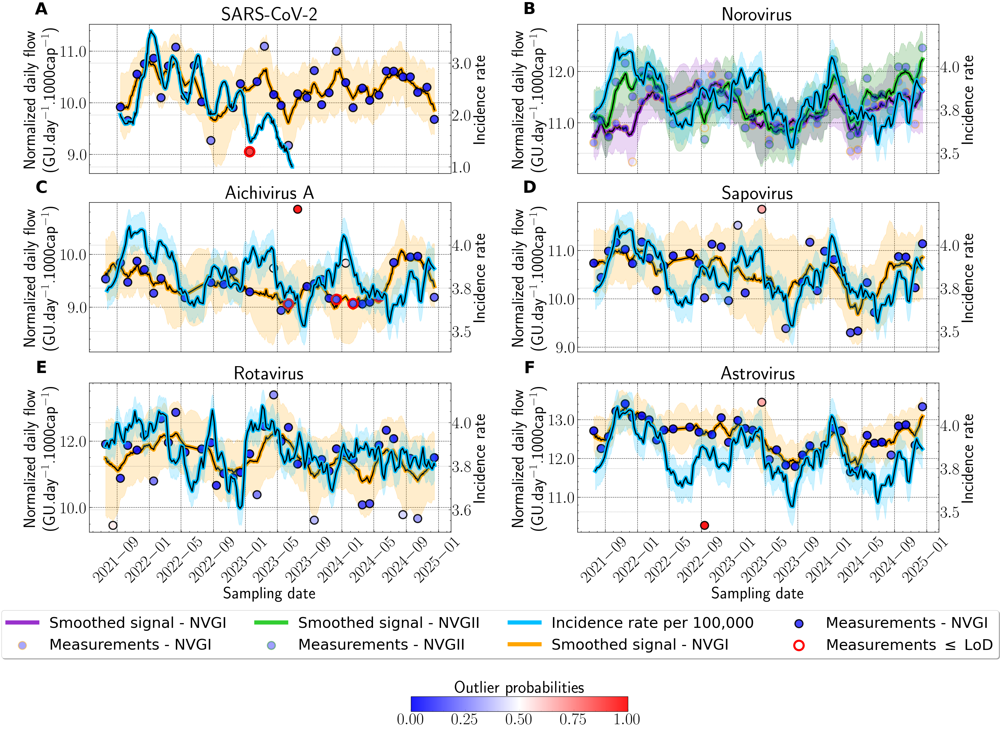

In [15]:
sub_data = ww_data_nvgi.copy()
sub_data_2 = ww_data_nvgii.copy()
this_molecule = 'Gastro'
ylabel = "Normalized daily flow\n (GU.day$^{-1}$.1000cap$^{-1}$)"

with plt.style.context(['science', 'notebook', 'grid']):

    ratio_factor = 1#0.875
    KEY_SIZE = int(40 * ratio_factor)
    LABEL_SIZE = int(40 * ratio_factor)
    TICK_SIZE = int(40 * ratio_factor)
    TITLE_SIZE = int(46 * ratio_factor)
    LEGEND_SIZE = int(36 * ratio_factor)
    DATES_SIZE = 18
    #figsize = (28, 14) #figsize = (32, 10)
    figsize = (32, 20) #figsize = (32, 10)
    
    plt.rc('axes', labelsize=LABEL_SIZE)
    plt.rc('xtick', labelsize=TICK_SIZE)   
    plt.rc('ytick', labelsize=TICK_SIZE)
    plt.rc('figure', titlesize=TITLE_SIZE)
    plt.rc('legend', fontsize=LEGEND_SIZE)
    plt.rcParams['text.usetex'] = True
    
    fig = plt.figure(figsize=figsize, layout="constrained")
    
    ax_dict = fig.subplot_mosaic(
        """
        AB
        CD
        EF
        """,
        gridspec_kw={'wspace': 0.05, 'hspace':0.05}
    )
    
    ######################################################### A #########################################################
    this_molecule = 'Norovirus'
    this_letter = 'B'
    scatter_alpha = 0.4
    ax_dict[this_letter].plot(sub_data.dateStart.values, sub_data.muX.values, label='Smoothed signal - NVGI', color='darkorchid', linewidth=10, zorder=3)
    ax_dict[this_letter].plot(sub_data.dateStart.values, sub_data.muX.values, color='black', linewidth=3, zorder=3)
        
    ax_dict[this_letter].fill_between(sub_data.dateStart.values, sub_data.ICL.values, sub_data.ICU.values, alpha=.2, color='darkorchid')

    
    scatter_points_1 = ax_dict[this_letter].scatter(sub_data.dateStart.values, sub_data.obs.values, label='Measurements - NVGI', 
                         c=sub_data.pout.values,
                         cmap='bwr', edgecolor='orange', s=360, zorder=3,
                         linewidths=3, alpha=scatter_alpha, vmin=0, vmax=1)

    ax_dict[this_letter].plot(sub_data_2.dateStart.values, sub_data_2.muX.values, label='Smoothed signal - NVGII', color='limegreen', linewidth=10, zorder=3)
    ax_dict[this_letter].plot(sub_data_2.dateStart.values, sub_data_2.muX.values, color='black', linewidth=3, zorder=3)
        
    ax_dict[this_letter].fill_between(sub_data_2.dateStart.values, sub_data_2.ICL.values, sub_data_2.ICU.values, alpha=.2, color='green')

    
    scatter_points_2 = ax_dict[this_letter].scatter(sub_data.dateStart.values, sub_data_2.obs.values, label='Measurements - NVGII', 
                         c=sub_data_2.pout.values, #marker='p',
                         cmap='bwr', edgecolor='green', s=360, zorder=3,
                         linewidths=3, alpha=scatter_alpha, vmin=0, vmax=1)
    
    # Cases
    ax_cases = ax_dict[this_letter].twinx()

    ax_cases.plot(cases_data.dateStart.values, cases_data.muX.values, color='deepskyblue', label='Incidence rate per 100,000', linewidth=10, zorder=3)
    ax_cases.plot(cases_data.dateStart.values, cases_data.muX.values, color='black', linewidth=3, zorder=3)

    ax_cases.fill_between(cases_data.dateStart.values, cases_data.ICL.values, cases_data.ICU.values, alpha=.2, color='deepskyblue')

    ax_dict[this_letter].set_ylabel(ylabel)
    ax_dict[this_letter].set_xlabel("Sampling date")
    ax_dict[this_letter].tick_params(axis='x', labelsize=TICK_SIZE, rotation=45)
    ax_dict[this_letter].tick_params(axis='y', labelsize=TICK_SIZE)
    ax_dict[this_letter].grid(linewidth=1, color='black', alpha=0.8)
    ax_dict[this_letter].set_title(this_molecule, size=TITLE_SIZE)
    
    ax_cases.set_ylabel("Incidence rate")

    ax_dict[this_letter].yaxis.set_major_formatter(digit_y_label)
    ax_cases.yaxis.set_major_formatter(digit_y_label)

    ######################################################### B #########################################################
    sub_data = ww_data_aichi.copy()
    scatter_alpha = 0.9
    color = 'orange'
    this_molecule = 'Aichivirus A'
    this_letter = 'C'
    ax_dict[this_letter].plot(sub_data.dateStart.values, sub_data.muX.values, label='Smoothed signal - NVGI', color=color, linewidth=10, zorder=3)
    ax_dict[this_letter].plot(sub_data.dateStart.values, sub_data.muX.values, color='black', linewidth=3, zorder=3)
        
    ax_dict[this_letter].fill_between(sub_data.dateStart.values, sub_data.ICL.values, sub_data.ICU.values, alpha=.2, color=color)

    
    scatter_points_1 = ax_dict[this_letter].scatter(sub_data.dateStart.values, sub_data.obs.values, label='Measurements - NVGI', 
                         c=sub_data.pout.values,
                         cmap='bwr', edgecolor='black', s=360, zorder=3,
                         linewidths=3, alpha=scatter_alpha, vmin=0, vmax=1)

    censored_obs_LP = sub_data.loc[sub_data.Raw_concentration==sub_data.Raw_lod]
    censored_points = ax_dict[this_letter].scatter(censored_obs_LP.dateStart.values,
                                           censored_obs_LP.obs.values, label='Measurements $\leq$ LoD', 
                         color='none', edgecolor='red', s=520, zorder=3, linewidth=5)
    
    # Cases
    ax_cases = ax_dict[this_letter].twinx()

    ax_cases.plot(cases_data.dateStart.values, cases_data.muX.values, color='deepskyblue', label='Incidence rate per 100,000', linewidth=10, zorder=3)
    ax_cases.plot(cases_data.dateStart.values, cases_data.muX.values, color='black', linewidth=3, zorder=3)

    ax_cases.fill_between(cases_data.dateStart.values, cases_data.ICL.values, cases_data.ICU.values, alpha=.2, color='deepskyblue')

    ax_dict[this_letter].set_ylabel(ylabel)
    ax_dict[this_letter].set_xlabel("Sampling date")
    ax_dict[this_letter].tick_params(axis='x', labelsize=TICK_SIZE, rotation=45)
    ax_dict[this_letter].tick_params(axis='y', labelsize=TICK_SIZE)
    ax_dict[this_letter].grid(linewidth=1, color='black', alpha=0.8)
    ax_dict[this_letter].set_title(this_molecule, size=TITLE_SIZE)
    
    ax_cases.set_ylabel("Incidence rate")    
    ax_dict[this_letter].yaxis.set_major_formatter(digit_y_label)
    ax_cases.yaxis.set_major_formatter(digit_y_label)
    ######################################################### C #########################################################
    sub_data = ww_data_astro.copy()
    color = 'orange'
    this_molecule = 'Astrovirus'
    this_letter = 'F'
    ax_dict[this_letter].plot(sub_data.dateStart.values, sub_data.muX.values, label='Smoothed signal', color=color, linewidth=10, zorder=3)
    ax_dict[this_letter].plot(sub_data.dateStart.values, sub_data.muX.values, color='black', linewidth=3, zorder=3)
        
    ax_dict[this_letter].fill_between(sub_data.dateStart.values, sub_data.ICL.values, sub_data.ICU.values, alpha=.2, color=color)

    
    scatter_points_1 = ax_dict[this_letter].scatter(sub_data.dateStart.values, sub_data.obs.values, label='Measurements', 
                         c=sub_data.pout.values,
                         cmap='bwr', edgecolor='black', s=360, zorder=3,
                         linewidths=3, alpha=scatter_alpha, vmin=0, vmax=1)

    censored_obs_LP = sub_data.loc[sub_data.Raw_concentration==sub_data.Raw_lod]
    censored_points = ax_dict[this_letter].scatter(censored_obs_LP.dateStart.values,
                                           censored_obs_LP.obs.values, label='Measurements $\leq$ LoD', 
                         color='none', edgecolor='red', s=520, zorder=3, linewidth=5)
    
    # Cases
    ax_cases = ax_dict[this_letter].twinx()

    ax_cases.plot(cases_data.dateStart.values, cases_data.muX.values, color='deepskyblue', label='Incidence rate per 100,000', linewidth=10, zorder=3)
    ax_cases.plot(cases_data.dateStart.values, cases_data.muX.values, color='black', linewidth=3, zorder=3)

    ax_cases.fill_between(cases_data.dateStart.values, cases_data.ICL.values, cases_data.ICU.values, alpha=.2, color='deepskyblue')

    ax_dict[this_letter].set_ylabel(ylabel)
    ax_dict[this_letter].set_xlabel("Sampling date")
    ax_dict[this_letter].tick_params(axis='x', labelsize=TICK_SIZE, rotation=45)
    ax_dict[this_letter].tick_params(axis='y', labelsize=TICK_SIZE)
    ax_dict[this_letter].grid(linewidth=1, color='black', alpha=0.8)
    ax_dict[this_letter].set_title(this_molecule, size=TITLE_SIZE)
    
    ax_cases.set_ylabel("Incidence rate")  
    ax_dict[this_letter].yaxis.set_major_formatter(digit_y_label)
    ax_cases.yaxis.set_major_formatter(digit_y_label)
    ######################################################### D #########################################################
    sub_data = ww_data_sapo.copy()
    this_molecule = 'Sapovirus'
    color = 'orange'
    this_letter = 'D'
    ax_dict[this_letter].plot(sub_data.dateStart.values, sub_data.muX.values, label='Smoothed signal - NVGI', color=color, linewidth=10, zorder=3)
    ax_dict[this_letter].plot(sub_data.dateStart.values, sub_data.muX.values, color='black', linewidth=3, zorder=3)
        
    ax_dict[this_letter].fill_between(sub_data.dateStart.values, sub_data.ICL.values, sub_data.ICU.values, alpha=.2, color=color)

    
    scatter_points_1 = ax_dict[this_letter].scatter(sub_data.dateStart.values, sub_data.obs.values, label='Measurements - NVGI', 
                         c=sub_data.pout.values,
                         cmap='bwr', edgecolor='black', s=360, zorder=3,
                         linewidths=3, alpha=scatter_alpha, vmin=0, vmax=1)

    censored_obs_LP = sub_data.loc[sub_data.Raw_concentration==sub_data.Raw_lod]
    censored_points = ax_dict[this_letter].scatter(censored_obs_LP.dateStart.values,
                                           censored_obs_LP.obs.values, label='Measurements $\leq$ LoD', 
                         color='none', edgecolor='red', s=520, zorder=3, linewidth=5)
    
    # Cases
    ax_cases = ax_dict[this_letter].twinx()

    ax_cases.plot(cases_data.dateStart.values, cases_data.muX.values, color='deepskyblue', label='Incidence rate per 100,000', linewidth=10, zorder=3)
    ax_cases.plot(cases_data.dateStart.values, cases_data.muX.values, color='black', linewidth=3, zorder=3)

    ax_cases.fill_between(cases_data.dateStart.values, cases_data.ICL.values, cases_data.ICU.values, alpha=.2, color='deepskyblue')

    ax_dict[this_letter].set_ylabel(ylabel)
    ax_dict[this_letter].set_xlabel("Sampling date")
    ax_dict[this_letter].tick_params(axis='x', labelsize=TICK_SIZE, rotation=45)
    ax_dict[this_letter].tick_params(axis='y', labelsize=TICK_SIZE)
    ax_dict[this_letter].grid(linewidth=1, color='black', alpha=0.8)
    ax_dict[this_letter].set_title(this_molecule, size=TITLE_SIZE)
    
    ax_cases.set_ylabel("Incidence rate")
    ax_dict[this_letter].yaxis.set_major_formatter(digit_y_label)
    ax_cases.yaxis.set_major_formatter(digit_y_label)
    ######################################################### E #########################################################
    sub_data = ww_data_rota.copy()
    this_molecule = 'Rotavirus'
    color = 'orange'
    this_letter = 'E'
    ax_dict[this_letter].plot(sub_data.dateStart.values, sub_data.muX.values, label='Smoothed signal - NVGI', color=color, linewidth=10, zorder=3)
    ax_dict[this_letter].plot(sub_data.dateStart.values, sub_data.muX.values, color='black', linewidth=3, zorder=3)
        
    ax_dict[this_letter].fill_between(sub_data.dateStart.values, sub_data.ICL.values, sub_data.ICU.values, alpha=.2, color=color)

    
    scatter_points_1 = ax_dict[this_letter].scatter(sub_data.dateStart.values, sub_data.obs.values, label='Measurements - NVGI', 
                         c=sub_data.pout.values,
                         cmap='bwr', edgecolor='black', s=360, zorder=3,
                         linewidths=3, alpha=scatter_alpha, vmin=0, vmax=1)

    censored_obs_LP = sub_data.loc[sub_data.Raw_concentration==sub_data.Raw_lod]
    censored_points = ax_dict[this_letter].scatter(censored_obs_LP.dateStart.values,
                                           censored_obs_LP.obs.values, label='Measurements $\leq$ LoD', 
                         color='none', edgecolor='red', s=520, zorder=3, linewidth=5)
    
    
    # Cases
    ax_cases = ax_dict[this_letter].twinx()

    ax_cases.plot(cases_data_rota.dateStart.values, cases_data_rota.muX.values, color='deepskyblue', label='Incidence rate per 100,000', linewidth=10, zorder=3)
    ax_cases.plot(cases_data_rota.dateStart.values, cases_data_rota.muX.values, color='black', linewidth=3, zorder=3)

    ax_cases.fill_between(cases_data_rota.dateStart.values, cases_data_rota.ICL.values, cases_data_rota.ICU.values, alpha=.2, color='deepskyblue')

    ax_dict[this_letter].set_ylabel(ylabel)
    ax_dict[this_letter].set_xlabel("Sampling date")
    ax_dict[this_letter].tick_params(axis='x', labelsize=TICK_SIZE, rotation=45)
    ax_dict[this_letter].tick_params(axis='y', labelsize=TICK_SIZE)
    ax_dict[this_letter].grid(linewidth=1, color='black', alpha=0.8)
    ax_dict[this_letter].set_title(this_molecule, size=TITLE_SIZE)
    
    ax_cases.set_ylabel("Incidence rate")
    ax_dict[this_letter].yaxis.set_major_formatter(digit_y_label)
    ax_cases.yaxis.set_major_formatter(digit_y_label)
    ######################################################### F #########################################################
    sub_data = ww_data_sars.copy()
    this_molecule = 'SARS-CoV-2'
    color = 'orange'
    this_letter = 'A'
    ax_dict[this_letter].plot(sub_data.dateStart.values, sub_data.muX.values, label='Smoothed signal - NVGI', color=color, linewidth=10, zorder=3)
    ax_dict[this_letter].plot(sub_data.dateStart.values, sub_data.muX.values, color='black', linewidth=3, zorder=3)
        
    ax_dict[this_letter].fill_between(sub_data.dateStart.values, sub_data.ICL.values, sub_data.ICU.values, alpha=.2, color=color)

    
    scatter_points_1 = ax_dict[this_letter].scatter(sub_data.dateStart.values, sub_data.obs.values, label='Measurements - NVGI', 
                         c=sub_data.pout.values,
                         cmap='bwr', edgecolor='black', s=360, zorder=3,
                         linewidths=3, alpha=scatter_alpha, vmin=0, vmax=1)

    censored_obs_LP = sub_data.loc[sub_data.Raw_concentration==sub_data.Raw_lod]
    censored_points = ax_dict[this_letter].scatter(censored_obs_LP.dateStart.values,
                                           censored_obs_LP.obs.values, label='Measurements $\leq$ LoD', 
                         color='none', edgecolor='red', s=520, zorder=3, linewidth=5)
    
    # Cases
    ax_cases = ax_dict[this_letter].twinx()

    ax_cases.plot(cases_data_sars.dateStart.values, cases_data_sars.signal.values, color='deepskyblue', label='Incidence rate per 100,000', linewidth=10, zorder=3)
    ax_cases.plot(cases_data_sars.dateStart.values, cases_data_sars.signal.values, color='black', linewidth=3, zorder=3)

    ax_dict[this_letter].set_ylabel(ylabel)
    ax_dict[this_letter].set_xlabel("Sampling date")
    ax_dict[this_letter].tick_params(axis='x', labelsize=TICK_SIZE, rotation=45)
    ax_dict[this_letter].tick_params(axis='y', labelsize=TICK_SIZE)
    ax_dict[this_letter].grid(linewidth=1, color='black', alpha=0.8)
    ax_dict[this_letter].set_title(this_molecule, size=TITLE_SIZE)
    
    ax_cases.set_ylabel("Incidence rate")
    ax_dict[this_letter].yaxis.set_major_formatter(digit_y_label)
    ax_cases.yaxis.set_major_formatter(digit_y_label)

    cmin, cmax = 0.0, 1.0 
    axins1 = inset_axes(ax_dict['F'], width='3000%', height='10%', 
                        bbox_to_anchor=(0.12, -2.1, 0.02, 1), 
                        bbox_transform=ax_dict['F'].transAxes, 
                        borderpad=0)
    axins1.grid(False)
    cbar = fig.colorbar(scatter_points_1, cax=axins1, orientation='horizontal')

    cbar.set_label('Outlier probabilities', labelpad=10, fontsize=LEGEND_SIZE+5)
    cbar.ax.xaxis.set_label_position('top')
    
    # Placing the label at the right spot - ajustez le labelpad pour la droite
    #cbar.ax.set_ylabel('Outlier probabilities', size=TICK_SIZE, loc='bottom')

    for this_key in ['A', 'C']:
        # SOLUTION ROBUSTE : Suppression complète des ticks X
        ax_dict[this_key].tick_params(axis='x', which='both', bottom=False, top=False, 
                                labelbottom=False, labeltop=False)
        ax_dict[this_key].set_xticks([])
        ax_dict[this_key].set_xticklabels([])
        ax_dict[this_key].set_xlabel('')
        # Assurer que les limites X sont identiques
        ax_dict[this_key].sharex(ax_dict['E'])

    for this_key in ['B', 'D']:
        # SOLUTION ROBUSTE : Suppression complète des ticks X
        ax_dict[this_key].tick_params(axis='x', which='both', bottom=False, top=False, 
                                labelbottom=False, labeltop=False)
        ax_dict[this_key].set_xticks([])
        ax_dict[this_key].set_xticklabels([])
        ax_dict[this_key].set_xlabel('')
        # Assurer que les limites X sont identiques
        ax_dict[this_key].sharex(ax_dict['F'])
    
    # Display subplot keys
    plt.rcParams['text.usetex'] = False
    fig.canvas.draw()
    
    # Function to align text with the ylabel of a specific axis
    def align_text_with_ylabel(ax, text, fig, offset=0.175):
        ylabel = ax.yaxis.label
        bbox = ylabel.get_window_extent()
        bbox_fig = fig.transFigure.inverted().transform(bbox)
        ylabel_center_fig_x = (bbox_fig[0, 0] + bbox_fig[1, 0]) / 2
        ylabel_center_fig_y = (bbox_fig[0, 1] + bbox_fig[1, 1]) / 2
        fig.text(ylabel_center_fig_x, ylabel_center_fig_y + offset, text, ha='center', va='center', size=KEY_SIZE, weight='bold')

    # Align text with the ylabels for each subplot
    for n, (key, ax) in enumerate(ax_dict.items()):
        align_text_with_ylabel(ax, key, fig, offset=0.15)

    this_molecule = 'Virological_analysis'
    
    # Main legend
    plt.rcParams['text.usetex'] = False
    h1, l1 = ax_dict['B'].get_legend_handles_labels()
    h3, l3 = ax_dict['C'].get_legend_handles_labels()
    h2, l2 = ax_cases.get_legend_handles_labels()
    fig.legend(h1+h2+h3, l1+l2+l3, loc='upper center', bbox_to_anchor=(0.5, 0), fancybox=True, shadow=True, ncol=4)
    plt.savefig("../outputs/figs/2025-12-25_" + this_molecule + "_pop_norm.pdf", bbox_inches = 'tight')
    plt.savefig("../outputs/figs/2025-12-25_" + this_molecule + "_pop_norm.jpg", bbox_inches = 'tight')
    
    plt.show()

/Users/nicolas/Documents/SUMMIT/Obépine/Etudes_annexes/2025-10-07_SIAAP_Manuscript_Folder/git/libs/cross_correlation_matcher_specific.py:266: UserWarning: This figure was using constrained_layout, but that is incompatible with subplots_adjust and/or tight_layout; disabling constrained_layout.
  fig.tight_layout()


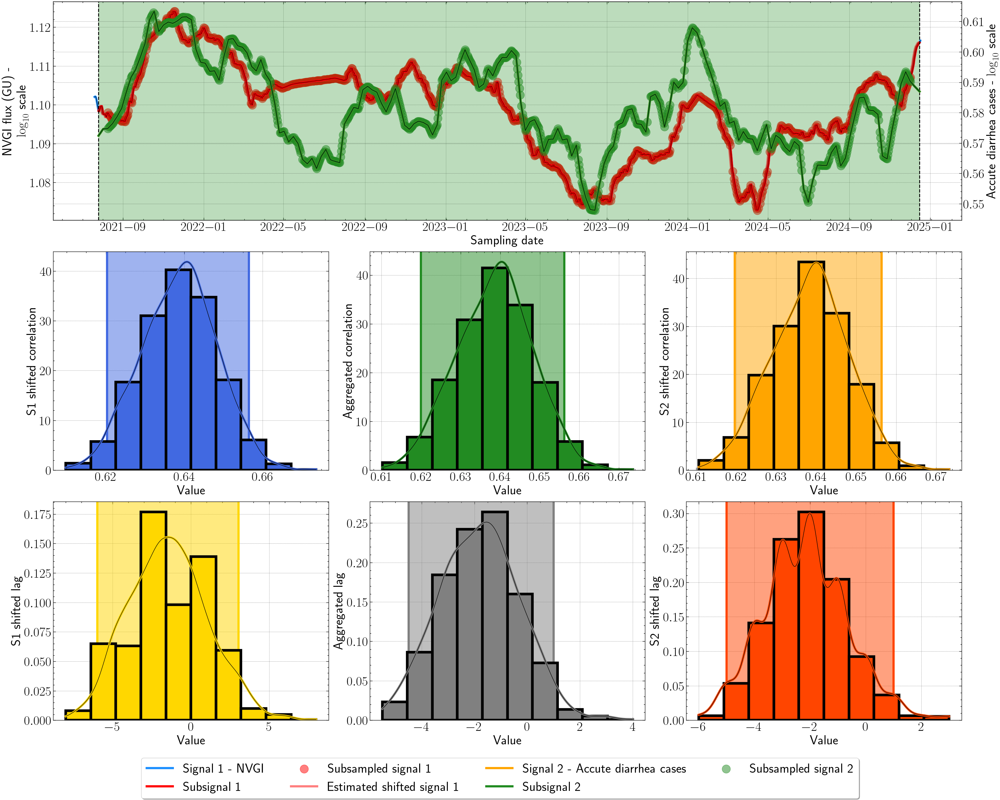

0.6385899137075595 -2.0
0.6199114074214441 0.6561576950073242


In [16]:
lag_limit = 14
sub_data = ww_data_astro.copy()
################################################################################################################

signal_1 = sub_data.loc[::, ['dateStart', 'muX']]
signal_2 = cases_data.loc[::, ['dateStart', 'muX']]

signal_1.muX = np.log10(signal_1.muX.values)
signal_2.muX = np.log10(signal_2.muX.values)

signal_1 = signal_1.rename(columns={'dateStart':'time', 'muX':'signal'})
signal_1 = signal_1.loc[::, ['time', 'signal']]

signal_2 = signal_2.rename(columns={'dateStart':'time', 'muX':'signal'})
signal_2 = signal_2.loc[::, ['time', 'signal']]

common_timestamps = np.intersect1d(signal_1.time.values, signal_2.time.values)

################################################################################################################

inside_left_bound = signal_2.time.tolist()[0] 
inside_right_bound = signal_2.time.tolist()[-1] 

signal_1_name = 'NVGI'
signal_2_name = 'Accute diarrhea cases'
signal_1_ylabel = 'NVGI flux (GU) - \n $\log_{10}$ scale'
signal_2_ylabel = 'Accute diarrhea cases  - $\log_{10}$ scale'
export_file_name = "../outputs/figs/" + "correlation_NVGI_cases" + ".pdf"

cd, ld = cross_correlation_matcher(signal_1, signal_2,
                          signal_1_name, signal_2_name,
                          signal_1_ylabel, signal_2_ylabel,
                          export_file_name,
                          lag_limit_left=-lag_limit, lag_limit_right=lag_limit+1,
                          inside_left_bound=inside_left_bound, inside_right_bound=inside_right_bound,
                          subsampling=True, ndraws=1000, fraction=0.75)

print(np.mean(cd), np.median(ld))
print(np.percentile(cd, 2.5), np.percentile(cd, 97.5))

/Users/nicolas/Documents/SUMMIT/Obépine/Etudes_annexes/2025-10-07_SIAAP_Manuscript_Folder/git/libs/cross_correlation_matcher_specific.py:266: UserWarning: This figure was using constrained_layout, but that is incompatible with subplots_adjust and/or tight_layout; disabling constrained_layout.
  fig.tight_layout()


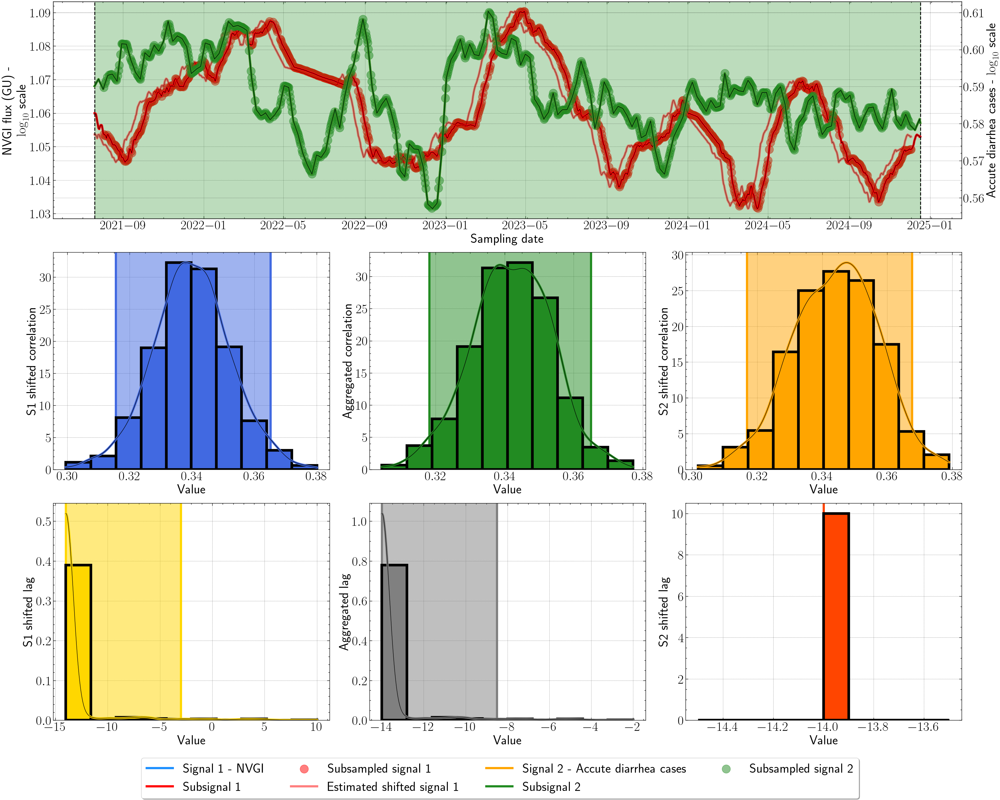

0.34198465224167995 -14.0
0.3181606587925027 0.36502096665559725


In [17]:
lag_limit = 14
sub_data = ww_data_rota
################################################################################################################

signal_1 = sub_data.loc[::, ['dateStart', 'muX']]
signal_2 = cases_data_rota.loc[::, ['dateStart', 'muX']]

signal_1.muX = np.log10(signal_1.muX.values)
signal_2.muX = np.log10(signal_2.muX.values)

signal_1 = signal_1.rename(columns={'dateStart':'time', 'muX':'signal'})
signal_1 = signal_1.loc[::, ['time', 'signal']]

signal_2 = signal_2.rename(columns={'dateStart':'time', 'muX':'signal'})
signal_2 = signal_2.loc[::, ['time', 'signal']]

common_timestamps = np.intersect1d(signal_1.time.values, signal_2.time.values)

################################################################################################################

inside_left_bound = signal_2.time.tolist()[0] 
inside_right_bound = signal_2.time.tolist()[-1] 

signal_1_name = 'NVGI'
signal_2_name = 'Accute diarrhea cases'
signal_1_ylabel = 'NVGI flux (GU) - \n $\log_{10}$ scale'
signal_2_ylabel = 'Accute diarrhea cases  - $\log_{10}$ scale'
export_file_name = "../outputs/figs/" + "correlation_NVGI_cases" + ".pdf"

cd, ld = cross_correlation_matcher(signal_1, signal_2,
                          signal_1_name, signal_2_name,
                          signal_1_ylabel, signal_2_ylabel,
                          export_file_name,
                          lag_limit_left=-lag_limit, lag_limit_right=lag_limit+1,
                          inside_left_bound=inside_left_bound, inside_right_bound=inside_right_bound,
                          subsampling=True, ndraws=1000, fraction=0.75)

print(np.mean(cd), np.median(ld))
print(np.percentile(cd, 2.5), np.percentile(cd, 97.5))

In [18]:
cases_data_sars = cases_data_sars.rename(columns={'signal':'muX'})

/Users/nicolas/Documents/SUMMIT/Obépine/Etudes_annexes/2025-10-07_SIAAP_Manuscript_Folder/git/libs/cross_correlation_matcher_specific.py:266: UserWarning: This figure was using constrained_layout, but that is incompatible with subplots_adjust and/or tight_layout; disabling constrained_layout.
  fig.tight_layout()


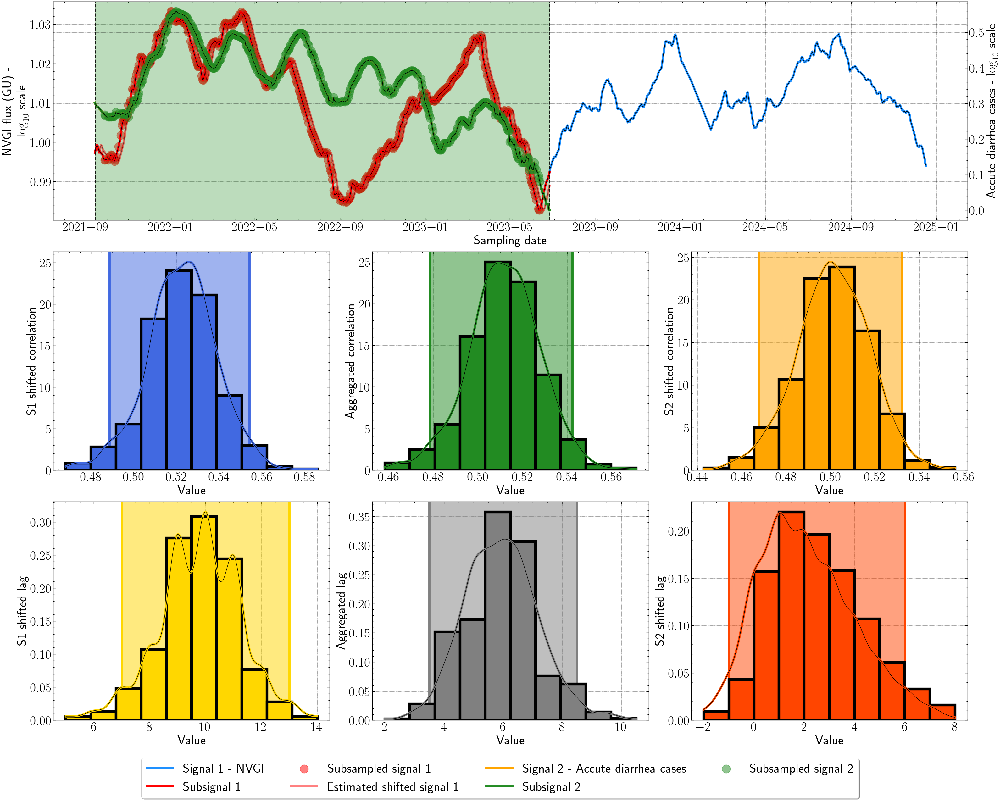

0.5117842390059444 6.0
0.4784716794175779 0.542279230560447


In [19]:
lag_limit = 14
sub_data = ww_data_sars
################################################################################################################

signal_1 = sub_data.loc[::, ['dateStart', 'muX']]
signal_2 = cases_data_sars.loc[::, ['dateStart', 'muX']]

signal_1.muX = np.log10(signal_1.muX.values)
signal_2.muX = np.log10(signal_2.muX.values)

signal_1 = signal_1.rename(columns={'dateStart':'time', 'muX':'signal'})
signal_1 = signal_1.loc[::, ['time', 'signal']]

signal_2 = signal_2.rename(columns={'dateStart':'time', 'muX':'signal'})
signal_2 = signal_2.loc[::, ['time', 'signal']]

common_timestamps = np.intersect1d(signal_1.time.values, signal_2.time.values)

################################################################################################################

inside_left_bound = signal_2.time.tolist()[0] 
inside_right_bound = signal_2.time.tolist()[-1] 

signal_1_name = 'NVGI'
signal_2_name = 'Accute diarrhea cases'
signal_1_ylabel = 'NVGI flux (GU) - \n $\log_{10}$ scale'
signal_2_ylabel = 'Accute diarrhea cases  - $\log_{10}$ scale'
export_file_name = "../outputs/figs/" + "correlation_NVGI_cases" + ".pdf"

cd, ld = cross_correlation_matcher(signal_1, signal_2,
                          signal_1_name, signal_2_name,
                          signal_1_ylabel, signal_2_ylabel,
                          export_file_name,
                          lag_limit_left=-lag_limit, lag_limit_right=lag_limit+1,
                          inside_left_bound=inside_left_bound, inside_right_bound=inside_right_bound,
                          subsampling=True, ndraws=1000, fraction=0.75)

print(np.mean(cd), np.median(ld))
print(np.percentile(cd, 2.5), np.percentile(cd, 97.5))

/Users/nicolas/Documents/SUMMIT/Obépine/Etudes_annexes/2025-10-07_SIAAP_Manuscript_Folder/git/libs/cross_correlation_matcher_specific.py:266: UserWarning: This figure was using constrained_layout, but that is incompatible with subplots_adjust and/or tight_layout; disabling constrained_layout.
  fig.tight_layout()


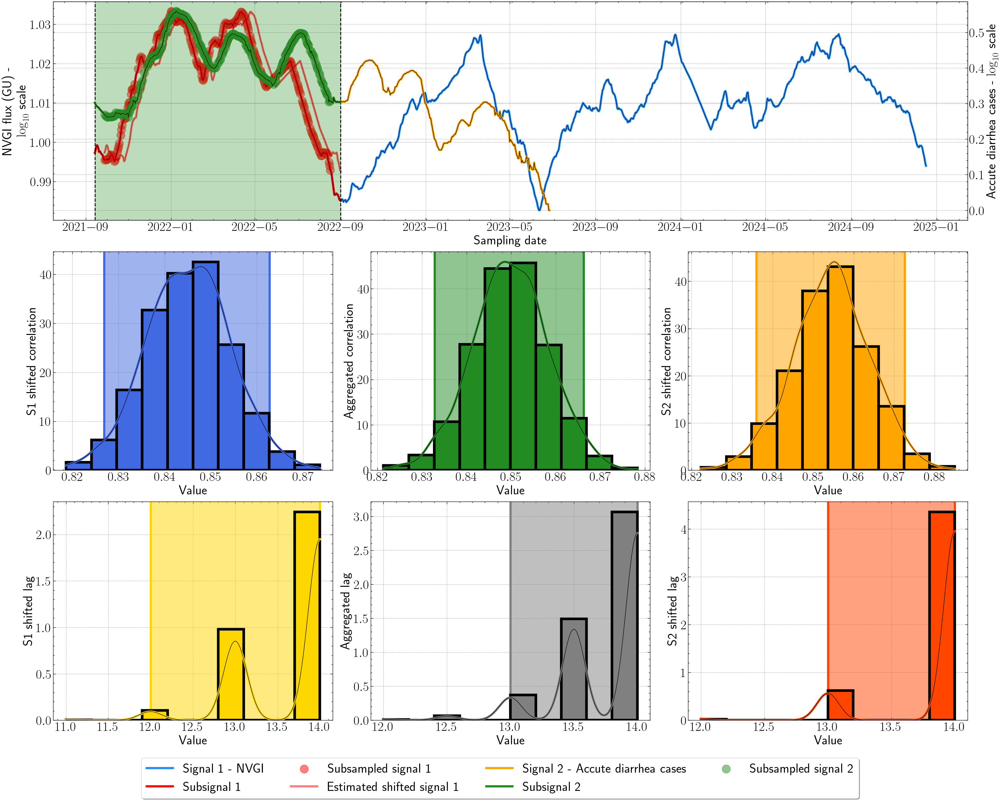

0.8498046133959215 14.0
0.8328597743437465 0.8662195516368068


In [20]:
lag_limit = 14
sub_data = ww_data_sars
################################################################################################################

signal_1 = sub_data.loc[::, ['dateStart', 'muX']]
signal_2 = cases_data_sars.loc[::, ['dateStart', 'muX']]

signal_1.muX = np.log10(signal_1.muX.values)
signal_2.muX = np.log10(signal_2.muX.values)

signal_1 = signal_1.rename(columns={'dateStart':'time', 'muX':'signal'})
signal_1 = signal_1.loc[::, ['time', 'signal']]

signal_2 = signal_2.rename(columns={'dateStart':'time', 'muX':'signal'})
signal_2 = signal_2.loc[::, ['time', 'signal']]

common_timestamps = np.intersect1d(signal_1.time.values, signal_2.time.values)

################################################################################################################

inside_left_bound = signal_2.time.tolist()[0] 
inside_right_bound = pd.to_datetime('2022-09-01')#signal_2.time.tolist()[-1] 

signal_1_name = 'NVGI'
signal_2_name = 'Accute diarrhea cases'
signal_1_ylabel = 'NVGI flux (GU) - \n $\log_{10}$ scale'
signal_2_ylabel = 'Accute diarrhea cases  - $\log_{10}$ scale'
export_file_name = "../outputs/figs/" + "correlation_NVGI_cases" + ".pdf"

cd, ld = cross_correlation_matcher(signal_1, signal_2,
                          signal_1_name, signal_2_name,
                          signal_1_ylabel, signal_2_ylabel,
                          export_file_name,
                          lag_limit_left=-lag_limit, lag_limit_right=lag_limit+1,
                          inside_left_bound=inside_left_bound, inside_right_bound=inside_right_bound,
                          subsampling=True, ndraws=1000, fraction=0.75)

print(np.mean(cd), np.median(ld))
print(np.percentile(cd, 2.5), np.percentile(cd, 97.5))

/Users/nicolas/Documents/SUMMIT/Obépine/Etudes_annexes/2025-10-07_SIAAP_Manuscript_Folder/git/libs/cross_correlation_matcher_specific.py:266: UserWarning: This figure was using constrained_layout, but that is incompatible with subplots_adjust and/or tight_layout; disabling constrained_layout.
  fig.tight_layout()


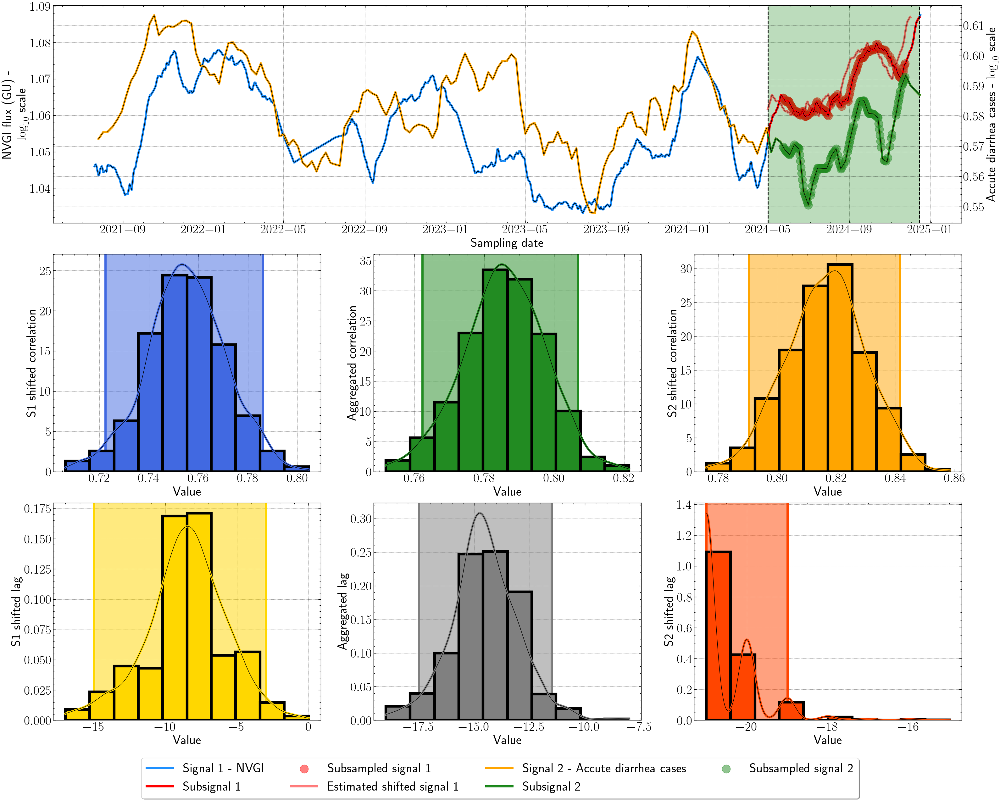

0.7856866022583299 -14.5
0.7622594045691983 0.8067829331644704


In [21]:
lag_limit = 21

sub_data = ww_data_nvgii.copy()
################################################################################################################

signal_1 = sub_data.loc[::, ['dateStart', 'muX']]
signal_2 = cases_data.loc[::, ['dateStart', 'muX']]

signal_1.muX = np.log10(signal_1.muX.values)
signal_2.muX = np.log10(signal_2.muX.values)

signal_1 = signal_1.rename(columns={'dateStart':'time', 'muX':'signal'})
signal_1 = signal_1.loc[::, ['time', 'signal']]

signal_2 = signal_2.rename(columns={'dateStart':'time', 'muX':'signal'})
signal_2 = signal_2.loc[::, ['time', 'signal']]

common_timestamps = np.intersect1d(signal_1.time.values, signal_2.time.values)

################################################################################################################

inside_left_bound = pd.to_datetime('2023-09-01') 
inside_right_bound = pd.to_datetime('2024-05-01') 

inside_left_bound = pd.to_datetime('2024-05-01') 
inside_right_bound = signal_2.time.tolist()[-1] #pd.to_datetime('2024-05-01') 

signal_1_name = 'NVGI'
signal_2_name = 'Accute diarrhea cases'
signal_1_ylabel = 'NVGI flux (GU) - \n $\log_{10}$ scale'
signal_2_ylabel = 'Accute diarrhea cases  - $\log_{10}$ scale'
export_file_name = "../outputs/figs/" + "correlation_NVGI_cases" + ".pdf"

cd, ld = cross_correlation_matcher(signal_1, signal_2,
                          signal_1_name, signal_2_name,
                          signal_1_ylabel, signal_2_ylabel,
                          export_file_name,
                          lag_limit_left=-lag_limit, lag_limit_right=lag_limit+1,
                          inside_left_bound=inside_left_bound, inside_right_bound=inside_right_bound,
                          subsampling=True, ndraws=1000, fraction=0.75)

print(np.mean(cd), np.median(ld))
print(np.percentile(cd, 2.5), np.percentile(cd, 97.5))

/Users/nicolas/Documents/SUMMIT/Obépine/Etudes_annexes/2025-10-07_SIAAP_Manuscript_Folder/git/libs/cross_correlation_matcher_specific.py:266: UserWarning: This figure was using constrained_layout, but that is incompatible with subplots_adjust and/or tight_layout; disabling constrained_layout.
  fig.tight_layout()


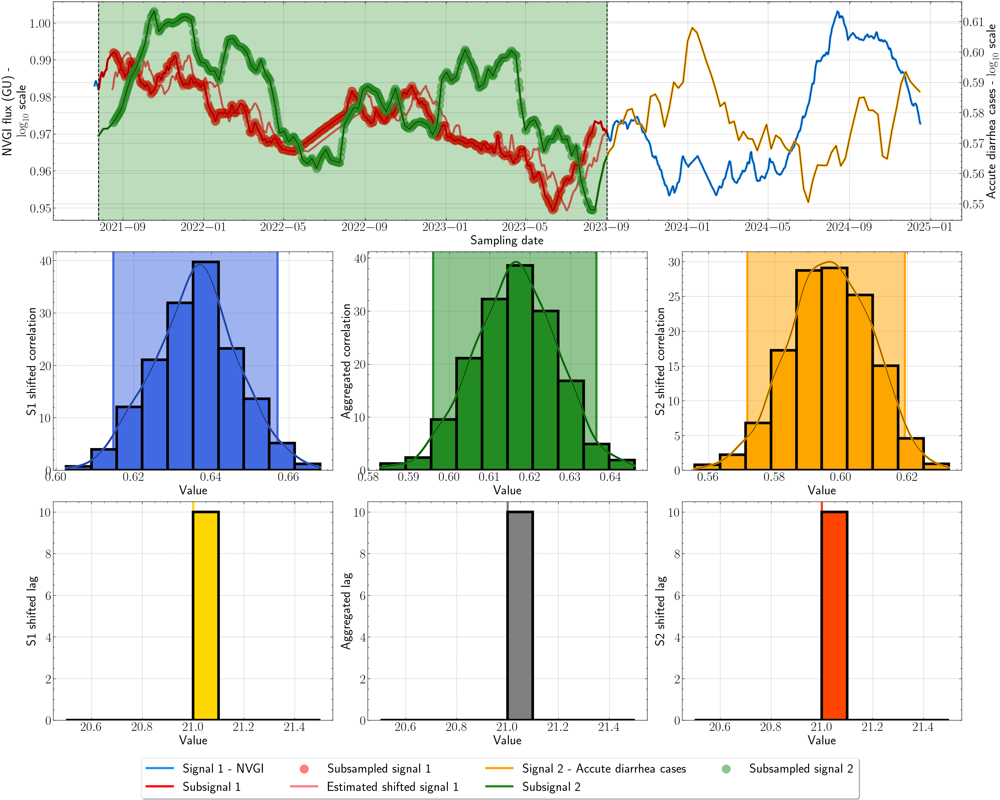

0.6163415828170874 21.0
0.5959232799648192 0.6364333847543664


In [22]:
lag_limit = 21

sub_data = ww_data_aichi.copy()
################################################################################################################

signal_1 = sub_data.loc[::, ['dateStart', 'muX']]
signal_2 = cases_data.loc[::, ['dateStart', 'muX']]

signal_1.muX = np.log10(signal_1.muX.values)
signal_2.muX = np.log10(signal_2.muX.values)

signal_1 = signal_1.rename(columns={'dateStart':'time', 'muX':'signal'})
signal_1 = signal_1.loc[::, ['time', 'signal']]

signal_2 = signal_2.rename(columns={'dateStart':'time', 'muX':'signal'})
signal_2 = signal_2.loc[::, ['time', 'signal']]

common_timestamps = np.intersect1d(signal_1.time.values, signal_2.time.values)

################################################################################################################

inside_left_bound = signal_2.time.tolist()[0]#pd.to_datetime('2023-09-01') 
inside_right_bound = pd.to_datetime('2023-09-01') 



signal_1_name = 'NVGI'
signal_2_name = 'Accute diarrhea cases'
signal_1_ylabel = 'NVGI flux (GU) - \n $\log_{10}$ scale'
signal_2_ylabel = 'Accute diarrhea cases  - $\log_{10}$ scale'
export_file_name = "../outputs/figs/" + "correlation_NVGI_cases" + ".pdf"

cd, ld = cross_correlation_matcher(signal_1, signal_2,
                          signal_1_name, signal_2_name,
                          signal_1_ylabel, signal_2_ylabel,
                          export_file_name,
                          lag_limit_left=-lag_limit, lag_limit_right=lag_limit+1,
                          inside_left_bound=inside_left_bound, inside_right_bound=inside_right_bound,
                          subsampling=True, ndraws=1000, fraction=0.75)

print(np.mean(cd), np.median(ld))
print(np.percentile(cd, 2.5), np.percentile(cd, 97.5))

/Users/nicolas/Documents/SUMMIT/Obépine/Etudes_annexes/2025-10-07_SIAAP_Manuscript_Folder/git/libs/cross_correlation_matcher_specific.py:266: UserWarning: This figure was using constrained_layout, but that is incompatible with subplots_adjust and/or tight_layout; disabling constrained_layout.
  fig.tight_layout()


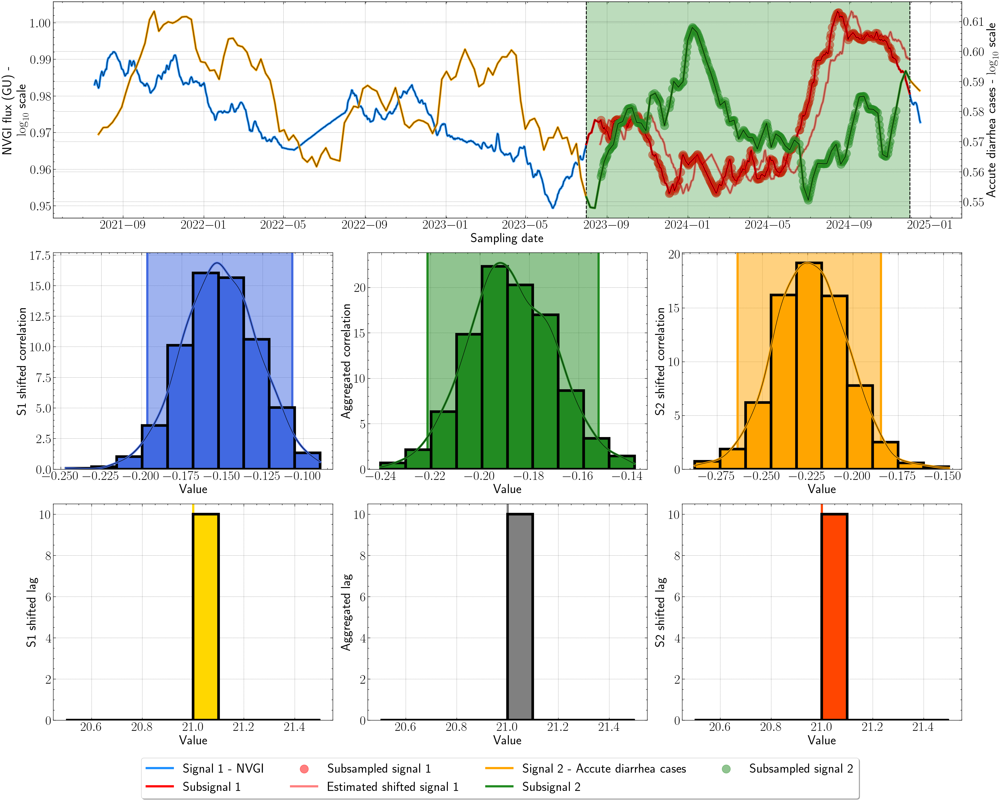

-0.18729659834171605 21.0


In [23]:
lag_limit = 21
################################################################################################################

signal_1 = sub_data.loc[::, ['dateStart', 'muX']]
signal_2 = cases_data.loc[::, ['dateStart', 'muX']]

signal_1.muX = np.log10(signal_1.muX.values)
signal_2.muX = np.log10(signal_2.muX.values)

signal_1 = signal_1.rename(columns={'dateStart':'time', 'muX':'signal'})
signal_1 = signal_1.loc[::, ['time', 'signal']]

signal_2 = signal_2.rename(columns={'dateStart':'time', 'muX':'signal'})
signal_2 = signal_2.loc[::, ['time', 'signal']]

common_timestamps = np.intersect1d(signal_1.time.values, signal_2.time.values)

################################################################################################################

inside_left_bound = pd.to_datetime('2023-08-01')
inside_right_bound = pd.to_datetime('2024-12-01')

signal_1_name = 'NVGI'
signal_2_name = 'Accute diarrhea cases'
signal_1_ylabel = 'NVGI flux (GU) - \n $\log_{10}$ scale'
signal_2_ylabel = 'Accute diarrhea cases  - $\log_{10}$ scale'
export_file_name = "../outputs/figs/" + "correlation_NVGI_cases" + ".pdf"

cd, ld = cross_correlation_matcher(signal_1, signal_2,
                          signal_1_name, signal_2_name,
                          signal_1_ylabel, signal_2_ylabel,
                          export_file_name,
                          lag_limit_left=-lag_limit, lag_limit_right=lag_limit+1,
                          inside_left_bound=inside_left_bound, inside_right_bound=inside_right_bound,
                          subsampling=True, ndraws=1000, fraction=0.75)

print(np.mean(cd), np.median(ld))

/Users/nicolas/Documents/SUMMIT/Obépine/Etudes_annexes/2025-10-07_SIAAP_Manuscript_Folder/git/libs/cross_correlation_matcher_specific.py:266: UserWarning: This figure was using constrained_layout, but that is incompatible with subplots_adjust and/or tight_layout; disabling constrained_layout.
  fig.tight_layout()


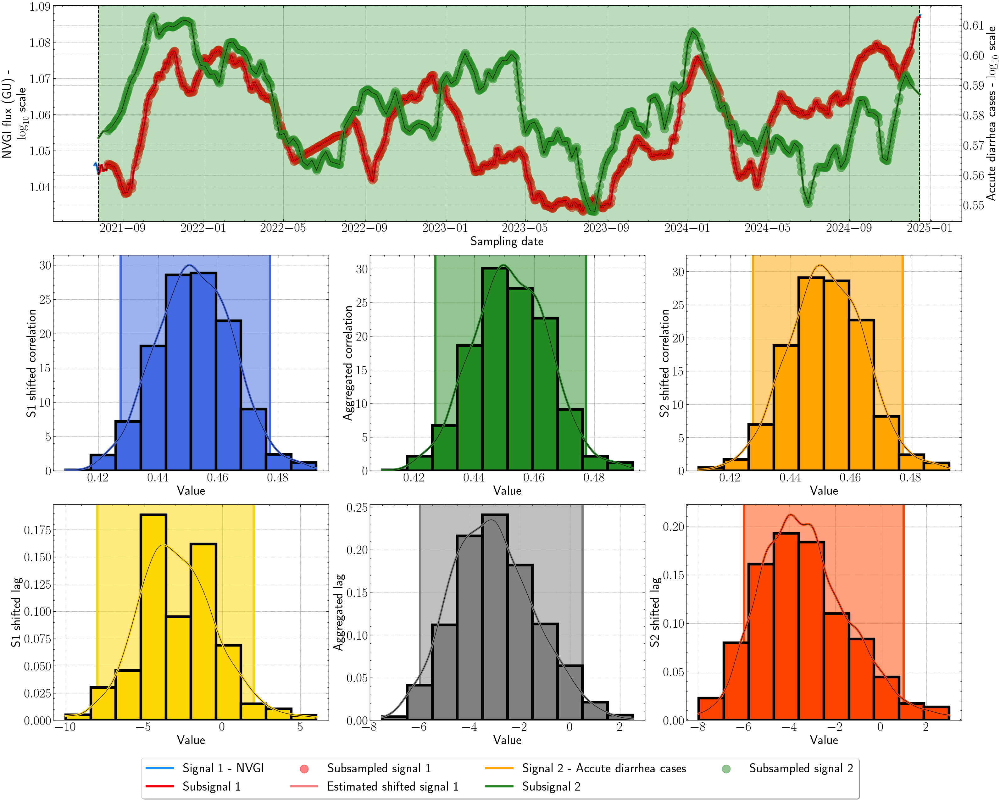

0.45209248343095965 -3.0


In [24]:
lag_limit = 14
sub_data = ww_data_nvgii.copy()
################################################################################################################

signal_1 = sub_data.loc[::, ['dateStart', 'muX']]
signal_2 = cases_data.loc[::, ['dateStart', 'muX']]

signal_1.muX = np.log10(signal_1.muX.values)
signal_2.muX = np.log10(signal_2.muX.values)

signal_1 = signal_1.rename(columns={'dateStart':'time', 'muX':'signal'})
signal_1 = signal_1.loc[::, ['time', 'signal']]

signal_2 = signal_2.rename(columns={'dateStart':'time', 'muX':'signal'})
signal_2 = signal_2.loc[::, ['time', 'signal']]

common_timestamps = np.intersect1d(signal_1.time.values, signal_2.time.values)

################################################################################################################

inside_left_bound = signal_2.time.tolist()[0] 
inside_right_bound = signal_2.time.tolist()[-1] 

signal_1_name = 'NVGI'
signal_2_name = 'Accute diarrhea cases'
signal_1_ylabel = 'NVGI flux (GU) - \n $\log_{10}$ scale'
signal_2_ylabel = 'Accute diarrhea cases  - $\log_{10}$ scale'
export_file_name = "../outputs/figs/" + "correlation_NVGI_cases" + ".pdf"

cd, ld = cross_correlation_matcher(signal_1, signal_2,
                          signal_1_name, signal_2_name,
                          signal_1_ylabel, signal_2_ylabel,
                          export_file_name,
                          lag_limit_left=-lag_limit, lag_limit_right=lag_limit+1,
                          inside_left_bound=inside_left_bound, inside_right_bound=inside_right_bound,
                          subsampling=True, ndraws=1000, fraction=0.75)

print(np.mean(cd), np.median(ld))

/Users/nicolas/Documents/SUMMIT/Obépine/Etudes_annexes/2025-10-07_SIAAP_Manuscript_Folder/git/libs/cross_correlation_matcher_specific.py:266: UserWarning: This figure was using constrained_layout, but that is incompatible with subplots_adjust and/or tight_layout; disabling constrained_layout.
  fig.tight_layout()


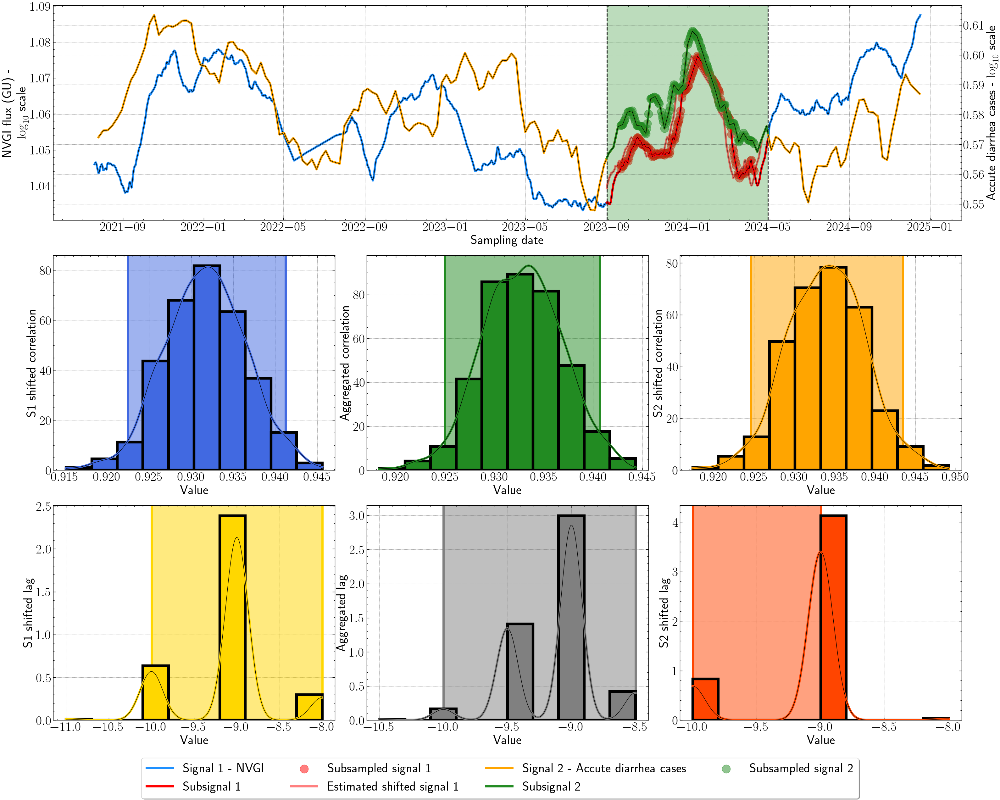

0.9328260717110006 -9.0


In [25]:
lag_limit = 21
################################################################################################################

signal_1 = sub_data.loc[::, ['dateStart', 'muX']]
signal_2 = cases_data.loc[::, ['dateStart', 'muX']]

signal_1.muX = np.log10(signal_1.muX.values)
signal_2.muX = np.log10(signal_2.muX.values)

signal_1 = signal_1.rename(columns={'dateStart':'time', 'muX':'signal'})
signal_1 = signal_1.loc[::, ['time', 'signal']]

signal_2 = signal_2.rename(columns={'dateStart':'time', 'muX':'signal'})
signal_2 = signal_2.loc[::, ['time', 'signal']]

common_timestamps = np.intersect1d(signal_1.time.values, signal_2.time.values)

################################################################################################################

inside_left_bound = pd.to_datetime('2023-09-01')
inside_right_bound = pd.to_datetime('2024-05-01')

signal_1_name = 'NVGI'
signal_2_name = 'Accute diarrhea cases'
signal_1_ylabel = 'NVGI flux (GU) - \n $\log_{10}$ scale'
signal_2_ylabel = 'Accute diarrhea cases  - $\log_{10}$ scale'
export_file_name = "../outputs/figs/" + "correlation_NVGI_cases" + ".pdf"

cd, ld = cross_correlation_matcher(signal_1, signal_2,
                          signal_1_name, signal_2_name,
                          signal_1_ylabel, signal_2_ylabel,
                          export_file_name,
                          lag_limit_left=-lag_limit, lag_limit_right=lag_limit+1,
                          inside_left_bound=inside_left_bound, inside_right_bound=inside_right_bound,
                          subsampling=True, ndraws=1000, fraction=0.75)

print(np.mean(cd), np.median(ld))

/Users/nicolas/Documents/SUMMIT/Obépine/Etudes_annexes/2025-10-07_SIAAP_Manuscript_Folder/git/libs/cross_correlation_matcher_specific.py:266: UserWarning: This figure was using constrained_layout, but that is incompatible with subplots_adjust and/or tight_layout; disabling constrained_layout.
  fig.tight_layout()


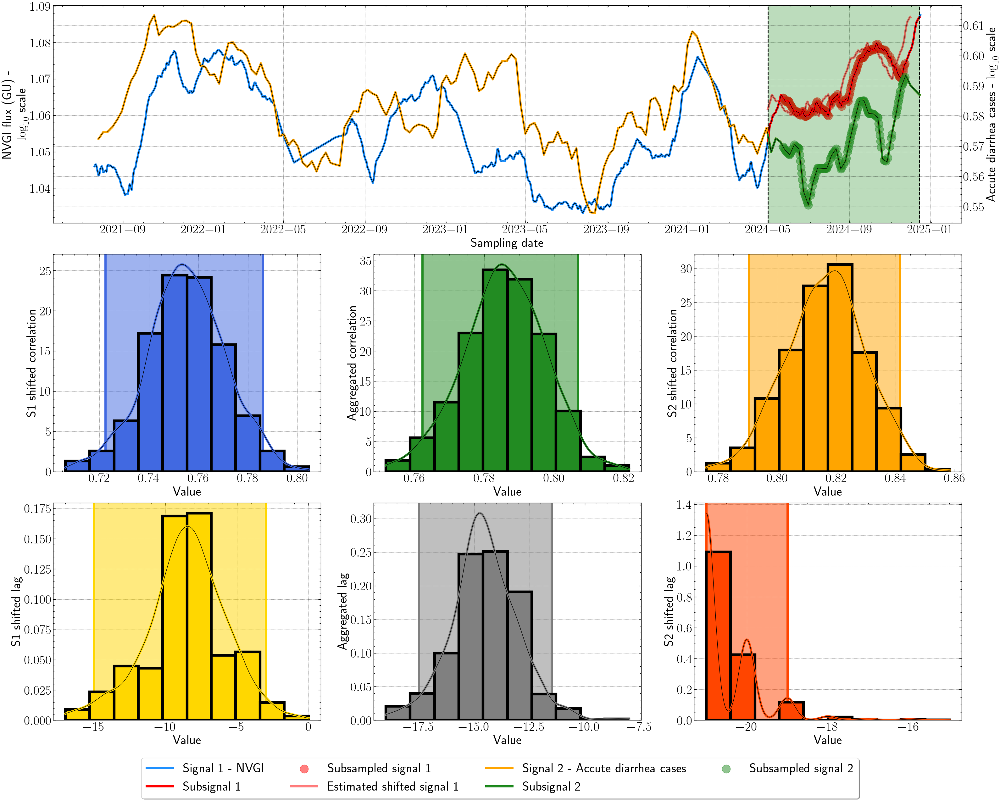

0.7856866022583299 -14.5


In [26]:
lag_limit = 21#14
################################################################################################################

signal_1 = sub_data.loc[::, ['dateStart', 'muX']]
signal_2 = cases_data.loc[::, ['dateStart', 'muX']]

signal_1.muX = np.log10(signal_1.muX.values)
signal_2.muX = np.log10(signal_2.muX.values)

signal_1 = signal_1.rename(columns={'dateStart':'time', 'muX':'signal'})
signal_1 = signal_1.loc[::, ['time', 'signal']]

signal_2 = signal_2.rename(columns={'dateStart':'time', 'muX':'signal'})
signal_2 = signal_2.loc[::, ['time', 'signal']]

common_timestamps = np.intersect1d(signal_1.time.values, signal_2.time.values)

################################################################################################################

inside_left_bound = pd.to_datetime('2024-05-01')
inside_right_bound = signal_2.time.tolist()[-1] #pd.to_datetime('2025-05-01')

signal_1_name = 'NVGI'
signal_2_name = 'Accute diarrhea cases'
signal_1_ylabel = 'NVGI flux (GU) - \n $\log_{10}$ scale'
signal_2_ylabel = 'Accute diarrhea cases  - $\log_{10}$ scale'
export_file_name = "../outputs/figs/" + "correlation_NVGI_cases" + ".pdf"

cd, ld = cross_correlation_matcher(signal_1, signal_2,
                          signal_1_name, signal_2_name,
                          signal_1_ylabel, signal_2_ylabel,
                          export_file_name,
                          lag_limit_left=-lag_limit, lag_limit_right=lag_limit+1,
                          inside_left_bound=inside_left_bound, inside_right_bound=inside_right_bound,
                          subsampling=True, ndraws=1000, fraction=0.75)

print(np.mean(cd), np.median(ld))

/Users/nicolas/Documents/SUMMIT/Obépine/Etudes_annexes/2025-10-07_SIAAP_Manuscript_Folder/git/libs/cross_correlation_matcher_specific.py:266: UserWarning: This figure was using constrained_layout, but that is incompatible with subplots_adjust and/or tight_layout; disabling constrained_layout.
  fig.tight_layout()


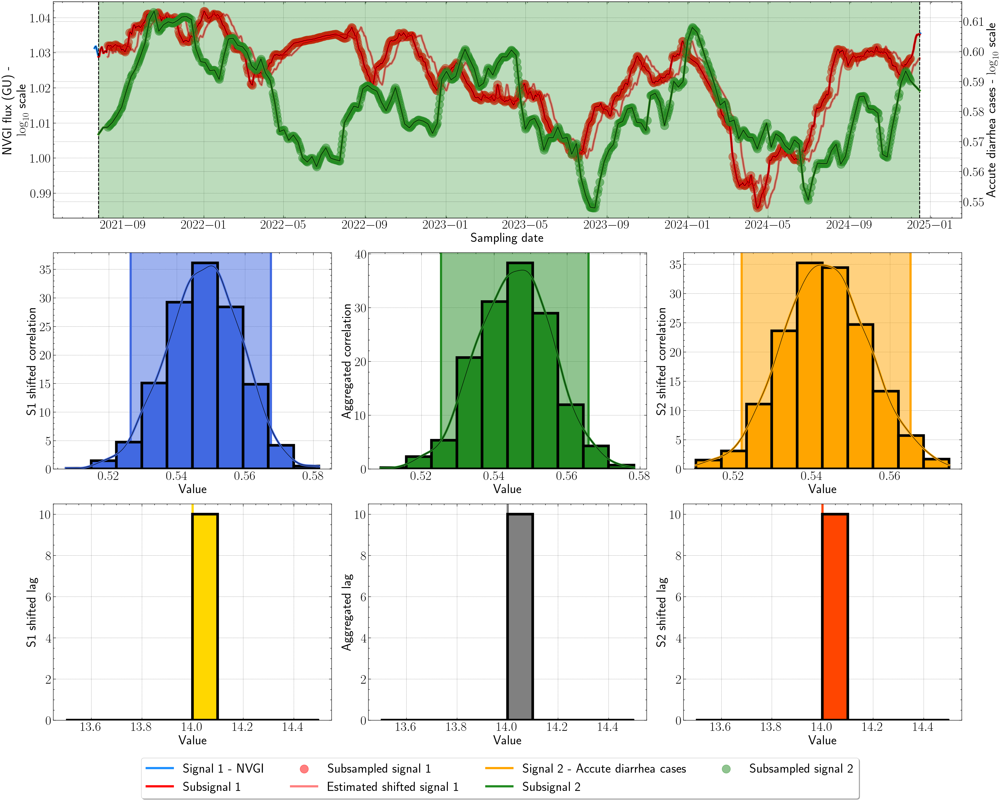

0.5456890166454642 14.0


In [27]:
lag_limit = 14
sub_data = ww_data_sapo.copy()
################################################################################################################

signal_1 = sub_data.loc[::, ['dateStart', 'muX']]
signal_2 = cases_data.loc[::, ['dateStart', 'muX']]

signal_1.muX = np.log10(signal_1.muX.values)
signal_2.muX = np.log10(signal_2.muX.values)

signal_1 = signal_1.rename(columns={'dateStart':'time', 'muX':'signal'})
signal_1 = signal_1.loc[::, ['time', 'signal']]

signal_2 = signal_2.rename(columns={'dateStart':'time', 'muX':'signal'})
signal_2 = signal_2.loc[::, ['time', 'signal']]

common_timestamps = np.intersect1d(signal_1.time.values, signal_2.time.values)

################################################################################################################

inside_left_bound = signal_2.time.tolist()[0] 
inside_right_bound = signal_2.time.tolist()[-1] 

signal_1_name = 'NVGI'
signal_2_name = 'Accute diarrhea cases'
signal_1_ylabel = 'NVGI flux (GU) - \n $\log_{10}$ scale'
signal_2_ylabel = 'Accute diarrhea cases  - $\log_{10}$ scale'
export_file_name = "../outputs/figs/" + "correlation_NVGI_cases" + ".pdf"

cd, ld = cross_correlation_matcher(signal_1, signal_2,
                          signal_1_name, signal_2_name,
                          signal_1_ylabel, signal_2_ylabel,
                          export_file_name,
                          lag_limit_left=-lag_limit, lag_limit_right=lag_limit+1,
                          inside_left_bound=inside_left_bound, inside_right_bound=inside_right_bound,
                          subsampling=True, ndraws=1000, fraction=0.75)

print(np.mean(cd), np.median(ld))

/Users/nicolas/Documents/SUMMIT/Obépine/Etudes_annexes/2025-10-07_SIAAP_Manuscript_Folder/git/libs/cross_correlation_matcher_specific.py:266: UserWarning: This figure was using constrained_layout, but that is incompatible with subplots_adjust and/or tight_layout; disabling constrained_layout.
  fig.tight_layout()


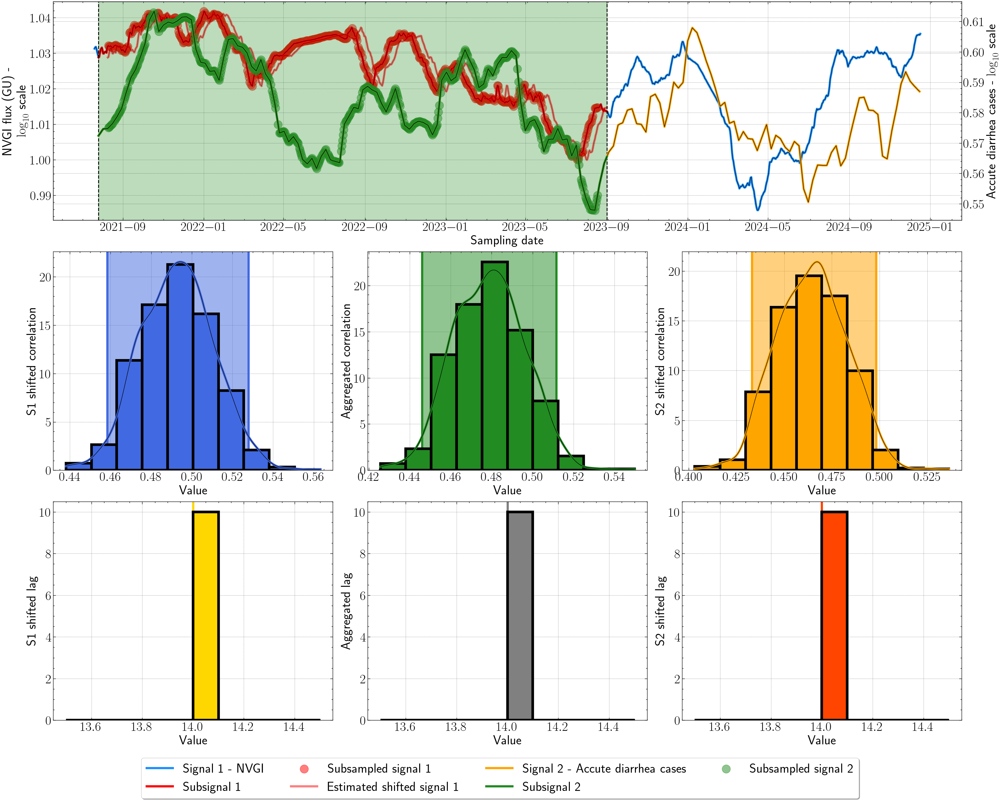

0.4787171905958022 14.0


In [28]:
lag_limit = 14
sub_data = ww_data_sapo.copy()
################################################################################################################

signal_1 = sub_data.loc[::, ['dateStart', 'muX']]
signal_2 = cases_data.loc[::, ['dateStart', 'muX']]

signal_1.muX = np.log10(signal_1.muX.values)
signal_2.muX = np.log10(signal_2.muX.values)

signal_1 = signal_1.rename(columns={'dateStart':'time', 'muX':'signal'})
signal_1 = signal_1.loc[::, ['time', 'signal']]

signal_2 = signal_2.rename(columns={'dateStart':'time', 'muX':'signal'})
signal_2 = signal_2.loc[::, ['time', 'signal']]

common_timestamps = np.intersect1d(signal_1.time.values, signal_2.time.values)

################################################################################################################

inside_left_bound = signal_2.time.tolist()[0] 
inside_right_bound = pd.to_datetime('2023-09-01')




signal_1_name = 'NVGI'
signal_2_name = 'Accute diarrhea cases'
signal_1_ylabel = 'NVGI flux (GU) - \n $\log_{10}$ scale'
signal_2_ylabel = 'Accute diarrhea cases  - $\log_{10}$ scale'
export_file_name = "../outputs/figs/" + "correlation_NVGI_cases" + ".pdf"

cd, ld = cross_correlation_matcher(signal_1, signal_2,
                          signal_1_name, signal_2_name,
                          signal_1_ylabel, signal_2_ylabel,
                          export_file_name,
                          lag_limit_left=-lag_limit, lag_limit_right=lag_limit+1,
                          inside_left_bound=inside_left_bound, inside_right_bound=inside_right_bound,
                          subsampling=True, ndraws=1000, fraction=0.75)

print(np.mean(cd), np.median(ld))

/Users/nicolas/Documents/SUMMIT/Obépine/Etudes_annexes/2025-10-07_SIAAP_Manuscript_Folder/git/libs/cross_correlation_matcher_specific.py:266: UserWarning: This figure was using constrained_layout, but that is incompatible with subplots_adjust and/or tight_layout; disabling constrained_layout.
  fig.tight_layout()


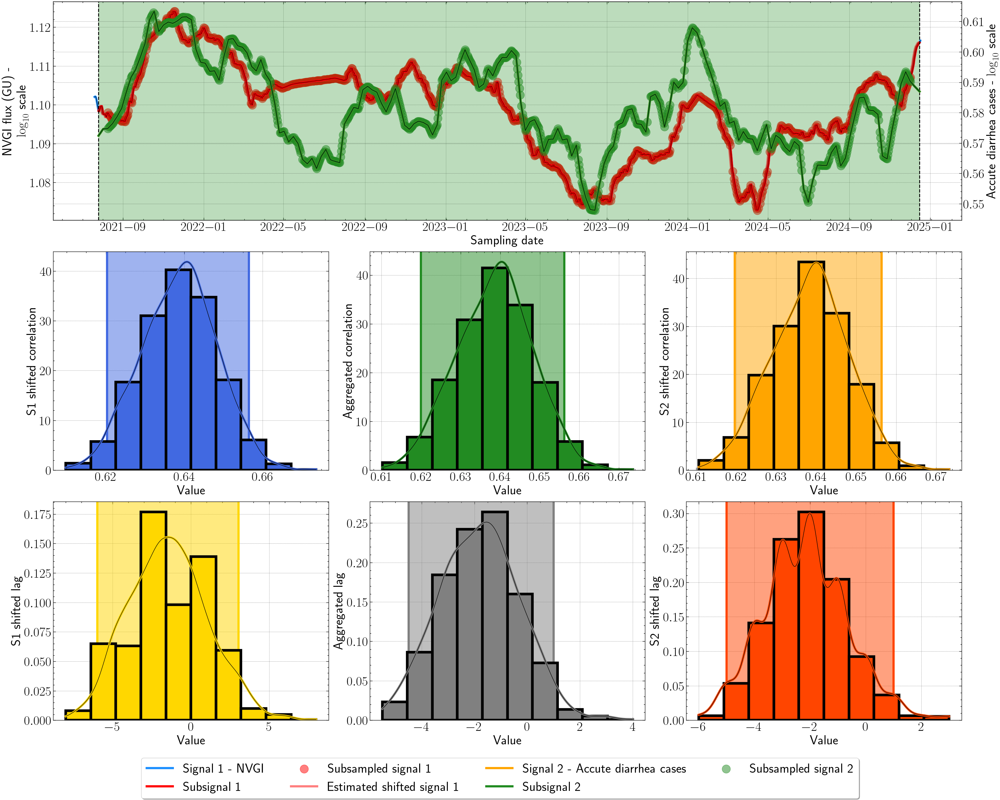

0.6385899137075595 -2.0


In [29]:
lag_limit = 14
sub_data = ww_data_astro.copy()
################################################################################################################

signal_1 = sub_data.loc[::, ['dateStart', 'muX']]
signal_2 = cases_data.loc[::, ['dateStart', 'muX']]

signal_1.muX = np.log10(signal_1.muX.values)
signal_2.muX = np.log10(signal_2.muX.values)

signal_1 = signal_1.rename(columns={'dateStart':'time', 'muX':'signal'})
signal_1 = signal_1.loc[::, ['time', 'signal']]

signal_2 = signal_2.rename(columns={'dateStart':'time', 'muX':'signal'})
signal_2 = signal_2.loc[::, ['time', 'signal']]

common_timestamps = np.intersect1d(signal_1.time.values, signal_2.time.values)

################################################################################################################

inside_left_bound = signal_2.time.tolist()[0] 
inside_right_bound = signal_2.time.tolist()[-1] 

signal_1_name = 'NVGI'
signal_2_name = 'Accute diarrhea cases'
signal_1_ylabel = 'NVGI flux (GU) - \n $\log_{10}$ scale'
signal_2_ylabel = 'Accute diarrhea cases  - $\log_{10}$ scale'
export_file_name = "../outputs/figs/" + "correlation_NVGI_cases" + ".pdf"

cd, ld = cross_correlation_matcher(signal_1, signal_2,
                          signal_1_name, signal_2_name,
                          signal_1_ylabel, signal_2_ylabel,
                          export_file_name,
                          lag_limit_left=-lag_limit, lag_limit_right=lag_limit+1,
                          inside_left_bound=inside_left_bound, inside_right_bound=inside_right_bound,
                          subsampling=True, ndraws=1000, fraction=0.75)

print(np.mean(cd), np.median(ld))

/Users/nicolas/Documents/SUMMIT/Obépine/Etudes_annexes/2025-10-07_SIAAP_Manuscript_Folder/git/libs/cross_correlation_matcher_specific.py:266: UserWarning: This figure was using constrained_layout, but that is incompatible with subplots_adjust and/or tight_layout; disabling constrained_layout.
  fig.tight_layout()


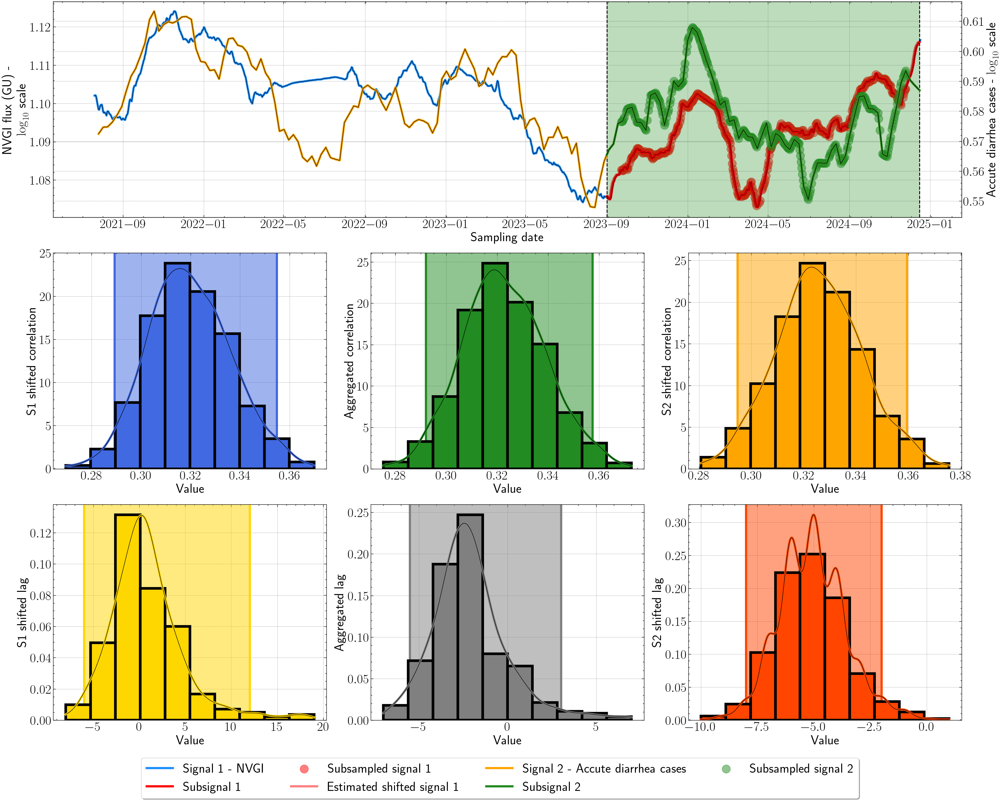

0.3227781655024206 -2.5


In [30]:
lag_limit = 21#14
################################################################################################################

signal_1 = sub_data.loc[::, ['dateStart', 'muX']]
signal_2 = cases_data.loc[::, ['dateStart', 'muX']]

signal_1.muX = np.log10(signal_1.muX.values)
signal_2.muX = np.log10(signal_2.muX.values)

signal_1 = signal_1.rename(columns={'dateStart':'time', 'muX':'signal'})
signal_1 = signal_1.loc[::, ['time', 'signal']]

signal_2 = signal_2.rename(columns={'dateStart':'time', 'muX':'signal'})
signal_2 = signal_2.loc[::, ['time', 'signal']]

common_timestamps = np.intersect1d(signal_1.time.values, signal_2.time.values)

################################################################################################################

inside_left_bound = pd.to_datetime('2023-09-01')
inside_right_bound = signal_2.time.tolist()[-1] #pd.to_datetime('2025-05-01')

signal_1_name = 'NVGI'
signal_2_name = 'Accute diarrhea cases'
signal_1_ylabel = 'NVGI flux (GU) - \n $\log_{10}$ scale'
signal_2_ylabel = 'Accute diarrhea cases  - $\log_{10}$ scale'
export_file_name = "../outputs/figs/" + "correlation_NVGI_cases" + ".pdf"

cd, ld = cross_correlation_matcher(signal_1, signal_2,
                          signal_1_name, signal_2_name,
                          signal_1_ylabel, signal_2_ylabel,
                          export_file_name,
                          lag_limit_left=-lag_limit, lag_limit_right=lag_limit+1,
                          inside_left_bound=inside_left_bound, inside_right_bound=inside_right_bound,
                          subsampling=True, ndraws=1000, fraction=0.75)

print(np.mean(cd), np.median(ld))